# Data Collection
The notebook contains OSM data collection, converting polygons to points and creating an interactive map of source data with Folium mapping library.

The scope of the project was to develop an area recommender system based on places that particular person liked before, using the example of San Francisco. For that purpose, I've used Points of Interests (POI) from [OpenStreetMaps](https://www.openstreetmap.org/#map=18/37.76552/-122.45014) (OSM) - crowdsorced global mapping database. OSM data is distributed under the Open Database License (ODbL) and its public usage requires attribution of data based on the application. All maps in this project will include the OSM reference.

There are several ways to download OSM data. My choice here was the OSMnx python library which is pretty fast and straightforward.

[OSMnx](https://osmnx.readthedocs.io/en/stable/) Is built on top of GeoPandas and NetworkX (which are built on top of matlotlib) utilizing their data structures and functionality. Documentation states the following:
> OSMnx geocodes place names and addresses with the OpenStreetMap Nominatim API. Using OSMnx’s geometries module, you can retrieve any geospatial objects (such as building footprints, grocery stores, schools, public parks, transit stops, etc) from the OpenStreetMap Overpass API as a GeoPandas GeoDataFrame. Using OSMnx’s graph module, you can retrieve any spatial network data (such as streets, paths, canals, etc) from the Overpass API and model them as NetworkX MultiDiGraphs.

OSMnx citation:
 > Boeing, G. 2017. OSMnx: New Methods for Acquiring, Constructing, Analyzing, and Visualizing Complex Street Networks. Computers, Environment and Urban Systems 65, 126-139. doi:10.1016/j.compenvurbsys.2017.05.004
 
### Python Libraries used in the project
Basic data science toolbox:
* pandas, numpy, matplotlib, seaborn
* sklearn: clustering algorythms and cosine similarity
* [K-Means constrained](https://joshlk.github.io/k-means-constrained/) - Advanced K-Means that allows to set min and max cluster size

Libraries for Geo Data:
* OSMnx mentioned above to collect OSM data
* [GeoPandas](https://geopandas.org/en/stable/) is an open source python library which is a geospatial extention of widely used pandas, but with an addition of geometrical functionality on top. Shapely often goes with it
* [Folium](https://python-visualization.github.io/folium/) - interactive mapping library built for python based on leaflet.js
* [TileMapBase](https://github.com/MatthewDaws/TileMapBase) - for quick static maps with OSM data on the background
* [Datashader](https://datashader.org/) (and Colorcet for color palette) - Good for plotting large datasets.

In [60]:
# Libraries import
import osmnx as ox # to query OSM data

import pandas as pd
import geopandas as gpd # for GeoDataFrames

# Mapping: Folium
import folium 

# Mapping: Datashader and Colorcet
import datashader as ds
from colorcet import fire
from datashader import transfer_functions as tf
from datashader.utils import export_image

_______
### OSM data collection

In [45]:
# Setting location for a OSM query
place = "San Francisco, California"

# Querying all objects tagged as amenities to a geopandas GeoDataFrame
tags = {'amenity': True}
gdf_full = ox.geometries_from_place(place, tags)

# Checking dimensions
gdf_full.shape

(14026, 615)

In [46]:
# Exploring GeoDataFrame
gdf_full

addr:city addr:housenumber addr:state  \
element_type osmid                                                 
node         61670779  San Francisco              530         CA   
             61671096            NaN              547        NaN   
             61671382            NaN              582        NaN   
             61672275            NaN              557        NaN   
             61673273  San Francisco              668         CA   
...                              ...              ...        ...   
relation     12305401            NaN              NaN        NaN   
             12619531            NaN             2850        NaN   
             12700499            NaN              NaN        NaN   
             13997496            NaN              NaN        NaN   
             14716347            NaN              NaN        NaN   

                         addr:street             alt_name            amenity  \
element_type osmid                                                             
node         61670779  Haight Street   Woods Beer;Lowside                pub   
             61671096  Haight Street                  NaN                pub   
             61671382  Haight Street                  NaN                pub   
             61672275  Haight Street                  NaN                pub   
             61673273  Haight Street                  NaN                pub   
...                              ...                  ...                ...   
relation     12305401            NaN                  NaN            parking   
             12619531    19th Avenue                  NaN  conference_centre   
             12700499            NaN                  NaN           fountain   
             13997496            NaN  Galileo High School             school   
             14716347            NaN                  NaN            parking   

                        branch contact:facebook contact:instagram  \
element_type osmid                                                  
node         61670779  Lowside      woodsbeerco         woodsbeer   
             61671096      NaN              NaN               NaN   
             61671382      NaN              NaN               NaN   
             61672275      NaN              NaN               NaN   
             61673273      NaN      dannycoyles               NaN   
...                        ...              ...               ...   
relation     12305401      NaN              NaN               NaN   
             12619531      NaN              NaN               NaN   
             12700499      NaN              NaN               NaN   
             13997496      NaN              NaN               NaN   
             14716347      NaN              NaN               NaN   

                      contact:twitter  ... was:addr:street was:addr:unit  \
element_type osmid                     ...                                 
node         61670779       woodsbeer  ...             NaN           NaN   
             61671096             NaN  ...             NaN           NaN   
             61671382             NaN  ...             NaN           NaN   
             61672275             NaN  ...             NaN           NaN   
             61673273   dannycoylessf  ...             NaN           NaN   
...                               ...  ...             ...           ...   
relation     12305401             NaN  ...             NaN           NaN   
             12619531             NaN  ...             NaN           NaN   
             12700499             NaN  ...             NaN           NaN   
             13997496             NaN  ...             NaN           NaN   
             14716347             NaN  ...             NaN           NaN   

                      building:min_level wall skateboard terminal  \
element_type osmid                                                  
node         61670779                NaN  NaN        NaN      NaN   
       

_______
### Converting polygons to points

OpenStreetMap data model is built on three fundamental map elements:
* Node
* Way
* Relation
  
**Node** is simply a single point, which is represented by a single combination of latitude and longitude, like address. **Way** is a line, like highway, it also may be a polygon if its first and last nodes are the same, for example - park. **Relation** is a group of elements (nodes, ways, relations) to define logical or geographic relationships between objects, for example: bus route consisting of several ways aka roads.  

In this project, I'm focusing on nodes and ways since both of them have amenity tags assigned. Ways need to be converted to points, using centroids function grom geopandas.

In [47]:
# Creating geometry type column to filter objects based on their OSM data structure
gdf_full['geom_type'] = gdf_full.index.map(lambda i: i[0])
gdf_full['geom_type'].value_counts()

node        10101
way          3890
relation       35
Name: geom_type, dtype: int64

In [61]:
# Looking at one of my favorite places' geometry, which is represented as a polygon (way in OSM language)
gdf_full[gdf_full.name == 'Linea Coffee Roasting']

,,addr:city,addr:housenumber,addr:state,addr:street,alt_name,amenity,branch,contact:facebook,contact:instagram,contact:twitter,...,was:addr:unit,building:min_level,wall,skateboard,terminal,ways,healthcare:for,community:wikidata,addr:street_1,geom_type
element_type,osmid,,,,,,,,,,,,,,,,,,,,,
way,267277641,NaN,1125,NaN,Mariposa Street,NaN,cafe,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,way


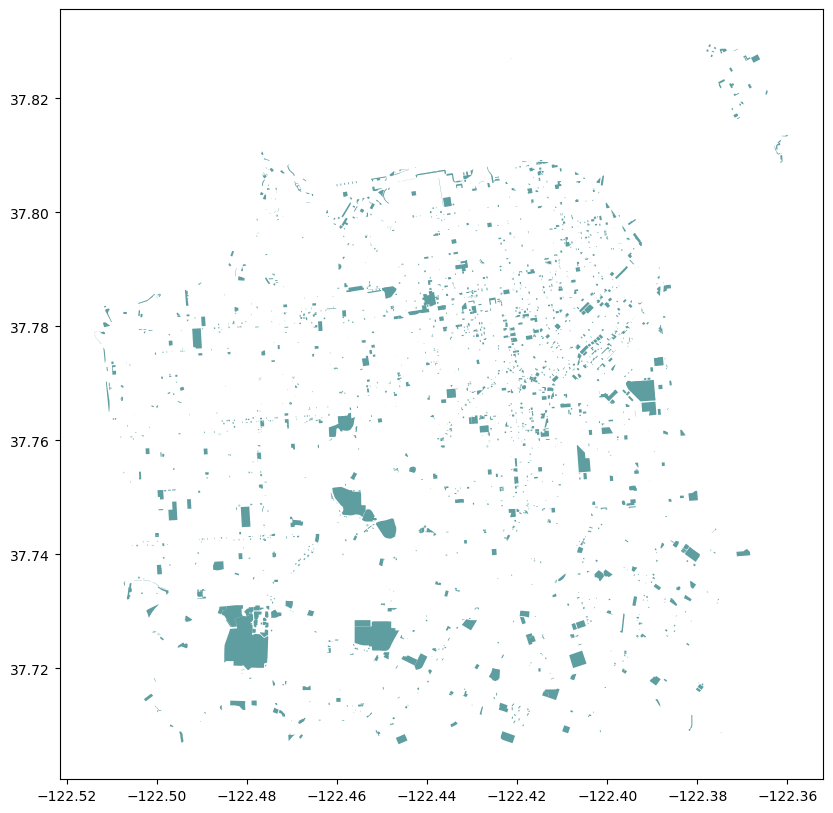

In [51]:
# Filtering GeoDataFrame to ways only
polys = gdf_full[gdf_full['geom_type'] == 'way']
polys.geometry

# Looking at ways geometry
polys.plot(color = 'cadetblue', figsize = (10, 10));

In [ ]:
# Converting polygons to points using centroids method from geopandas
centroids = polys.centroid
polys.geometry = centroids

In [62]:
# Filtering GeoDataFrame to nodes (points) only
gdf = gdf_full[gdf_full['geom_type'] == 'node']
gdf.shape

(10101, 616)

In [63]:
# Concatenating filtered GeoDataFrame with polygons that were converted to centroids
gdf = pd.concat([gdf, polys])
gdf.shape

(13991, 616)

In [64]:
# Making osmid column an index of the GeoDataFrame
gdf.index = gdf.index.map(lambda i: i[1])
gdf.head(1)

,addr:city,addr:housenumber,addr:state,addr:street,alt_name,amenity,branch,contact:facebook,contact:instagram,contact:twitter,...,was:addr:unit,building:min_level,wall,skateboard,terminal,ways,healthcare:for,community:wikidata,addr:street_1,geom_type
61670779,San Francisco,530,CA,Haight Street,Woods Beer;Lowside,pub,Lowside,woodsbeerco,woodsbeer,woodsbeer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,node


_____________
### Mapping points
Exploratory Data Analysis of this project is mainly about looking at points' spatial distributuion and their attributes. For this purpose, I'm going to create several interactive maps by using folium library. I've also tried Datashader, because after some initial research on the web I've found out that it works better for large datasets than folium. However, my dataset turned out to be not big enough to encounter any issues with folium. It was especially helpful for the EDA purposes due to it's interactive functionality.

In [56]:
# Looking at geometry column
gdf[['geometry']].head(5)

,geometry
61670779,POINT (-122.43102 37.77214)
61671096,POINT (-122.43122 37.77191)
61671382,POINT (-122.43176 37.77205)
61672275,POINT (-122.43142 37.77189)
61673273,POINT (-122.43326 37.77186)


In [57]:
# Querying top amenities
gdf.amenity.value_counts()[:13]

bench               2309
restaurant          1865
parking_space       1417
parking             1032
bicycle_parking      880
cafe                 732
waste_basket         622
post_box             537
place_of_worship     389
fast_food            356
bar                  324
school               260
bank                 235
Name: amenity, dtype: int64

In [58]:
# Filtering GeoDataFrame to amenity types and geometry only to reduce memory usage when mapping them
gdf_min = gdf[['amenity', 'geometry']]
gdf_min.head(1)

,amenity,geometry
61670779,pub,POINT (-122.43102 37.77214)


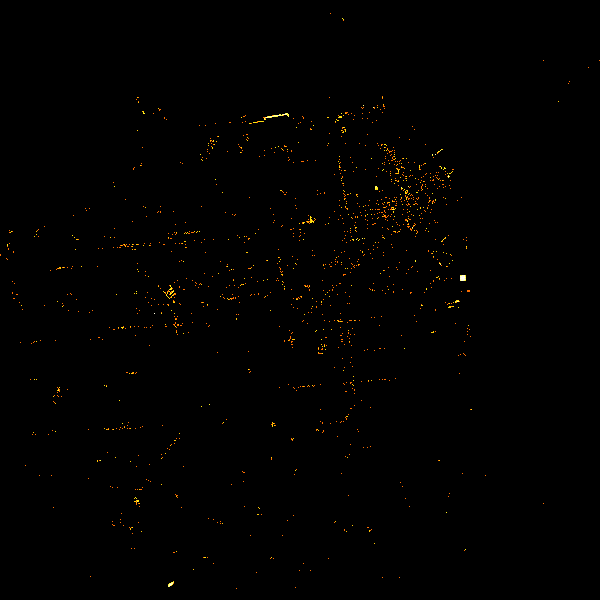

In [65]:
# Looking at heatmap of points via Datashader library
gdf_min['lon'] = gdf_min.geometry.x # extracting longitude
gdf_min['lat'] = gdf_min.geometry.y # latitude

# Plotting places
agg = ds.Canvas().points(gdf_min, 'lon', 'lat')
img = tf.set_background(tf.shade(agg, cmap=fire),'black')

# Saving image
export_image(img, 'datashader', background='black', export_path='../output')

# Display 
img

In [69]:
# Creating a color column specifically for the logic in which folium works. It has only several color options, so I'm assigning colors manually to top categories
gdf_min['color'] = gdf_min['amenity'].map({'bench': 'gray', 
                                           'restaurant': 'cadetblue', 
                                           'bicycle_parking': 'darkpurple', 
                                           'cafe': 'blue', 
                                           'place_of_worship': 'pink', 
                                           'post_box': 'beige', 
                                           'fast_food': 'lightblue', 
                                           'bar': 'lightgreen', 
                                           'drinking_water':'white', 
                                           'bank': 'darkred',
                                           'parking_entrance':'darkgreen',
                                           'atm': 'lightred',
                                           'car_sharing' : 'orange'})

# Filling non-top categories with lightgrey
gdf_min.fillna(value='lightgray', inplace = True)

In [70]:
# Creating a base map
m = folium.Map(location = [37.7775, -122.416389], # map center coordinates from San Francisco Wikipedia page
               tiles="Cartodb dark_matter", # theme
               zoom_start=15, # default zoom
               min_zoom=12, # parameter that doesn't allow to zoom out too far
               max_bounds=True) 

# Adding points
for lon, lat, col, amenity in zip(gdf_min.geometry.x, gdf_min.geometry.y, gdf_min.color, gdf_min.amenity): # iterating through every row
    folium.CircleMarker([lat, lon],  # marker location
                        radius = 2,  # marker size
                        fill_color = col, # defined color per category from created column
                        fill=True, # only fill color
                        color=False, # transparent outline
                        fill_opacity = 0.5, # transparency
                        popup = amenity # if to click on point, POI category will appear
                       ).add_to(m)    
    
m.save('../output/POI.html') # saving map

m # displaying map

In [72]:
# Saving GeoDataFrame 
gdf.to_csv('../data/POIs_raw.csv')

To sum this up, I used OSMnx library to download all map objects tagged as amenity for the city of San Francisco. Then I converted polygon amenities to points, using their centroids. Notebook ends with interactive map, which I used to guide my decision making when filtering data in the next notebook called '02_feature_engineering'.